# Script to aquire and pre-process OSM data to an Xarray cube

In [6]:
## Import libraries
# system
import os
import sys
import time
import calendar
import io
import requests
import multiprocessing as mp
from concurrent.futures import ThreadPoolExecutor, as_completed
import threading
from dotenv import load_dotenv
import logging


# aws bucket access
import boto3

# data manipulation
import duckdb
import polars as pl
import json
import random
import overpass
from PIL import Image
from io import BytesIO
import numpy as np
import pandas as pd
import geopandas as gpd
import osmnx as ox
import rasterio as rio
import xarray as xr
import rioxarray as rxr
from rasterio.transform import from_bounds
from rasterio.features import geometry_mask, rasterize
from pyproj import Transformer, CRS
from shapely.geometry import box, shape, Polygon
#from samgeo import tms_to_geotiff

# visualization
from rasterio.plot import show
import leafmap
import folium
from ipyleaflet import Map, WMSLayer, basemaps, TileLayer, DrawControl, FullScreenControl, LayersControl, MeasureControl, SplitMapControl, WidgetControl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib as mpl
import seaborn as sns
from tqdm import tqdm

repo_name = 'masterthesis_genai_spatialplan'
if not repo_name in os.getcwd():
    os.chdir(repo_name)

p=os.popen('git rev-parse --show-toplevel')
repo_dir = p.read().strip()
p.close()

#seaborn cmap
rocket=sns.color_palette("rocket", as_cmap=True)
mako=sns.color_palette("mako", as_cmap=True)

### Get the boundaries of Leipzig

In [8]:
# Define bbox for entire Leipzig
xmin, ymin = 12.2714, 51.2705  # Southwest corner
xmax, ymax = 12.5019, 51.4174  # Northeast corner

# Create bbox polygon
bbox = box(xmin, ymin, xmax, ymax)

# Create GeoDataFrame
bbox_gdf = gpd.GeoDataFrame(geometry=[bbox], crs="EPSG:4326")

bbox_gdf.explore()

Create a grid for multithreading

In [9]:
# xmin, ymin, xmax, ymax = gdf.total_bounds
length = 0.03
width = 0.03

cols = list(np.arange(xmin, xmax + width, width))
rows = list(np.arange(ymin, ymax +length, length))

polygons = []
for x in cols[:-1]:
    for y in rows[:-1]:
        polygons.append(Polygon([
            (x, y), (x+width, y), (x+width, y+length), (x, y+length)
        ]))
grid = gpd.GeoDataFrame(geometry=polygons, crs="EPSG:4326")
# grid =gpd.overlay(grid, gdf, how='intersection')
grid.explore()

## Request OpenStreetMap Data

First try with the landuse

In [4]:
ox.settings.use_cache = True

bbox = (xmin, ymin, xmax, ymax)

# Define tags query
tags = {"landuse": True}  # True gets all landuse values

# Extract features
landuse_gdf = ox.features_from_bbox(
    (bbox[0],  # left
    bbox[1],  # bottom
    bbox[2],  # right
    bbox[3]),  # top
    tags=tags
)

# Clean and display
landuse_gdf = landuse_gdf[landuse_gdf.geometry.is_valid]
print(f"Number of features: {len(landuse_gdf)}")
print("\nLanduse types:")
print(landuse_gdf['landuse'].value_counts())

Number of features: 13191

Landuse types:
landuse
grass                      8106
residential                1227
allotments                  536
meadow                      505
forest                      437
farmland                    343
commercial                  329
construction                226
garages                     214
industrial                  214
brownfield                  197
railway                     187
retail                      165
village_green               100
flowerbed                    93
basin                        53
cemetery                     50
farmyard                     44
recreation_ground            34
greenfield                   33
orchard                      20
greenhouse_horticulture      17
religious                    14
landfill                     10
plant_nursery                 8
education                     3
reservoir                     3
quarry                        3
greenland                     2
military              

Explore the requested land use

In [ ]:
landuse_gdf[0:2000].explore()

In [ ]:
landuse_gdf.explore()

### Request data for a sample area

In [ ]:
#get everythign for a smaller area first

# Define bbox for urban area in Leipzig 
xmin_sample, ymin_sample = 12.3735, 51.324  # Southwest corner
xmax_sample, ymax_sample = 12.3935, 51.3321  # Northeast corner

# Create bbox polygon
bbox_sample = (xmin_sample, ymin_sample, xmax_sample, ymax_sample)

# get streets, water, parks and buildings, landuse
tags = {
    "building": True,
    "waterway": True,
    "natural": True, #["water", "wood", "grassland"],
    "highway": True,
    "landuse": True,
    "leisure": ["park", "garden"],
    "place": ["square"],
    "amenity": ["fountain", "school", "university", "college", "hospital", "kindergarten", "place_of_worship"],
    "aeroway": True,
    "railway": True,
}

# Extract features
leipzig_urban_gdf = ox.features_from_bbox(
    bbox=bbox_sample,
    tags=tags
)

# Clean and display
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]
print(f"Number of features: {len(leipzig_urban_gdf)}")
print("\nFeature types:")
print(leipzig_urban_gdf['geometry'].type.value_counts())

Number of features: 3022

Feature types:
LineString      1459
Polygon          928
Point            632
MultiPolygon       3
Name: count, dtype: int64


In [19]:
leipzig_urban_gdf.explore()

### Rasterize the data

In [16]:
# filter out only buildings
buildings_gdf = leipzig_urban_gdf[leipzig_urban_gdf["building"].notnull()]
geom = [shapes for shapes in buildings_gdf.geometry]
transform = from_bounds(xmin, ymin, xmax, ymax, 1024, 1024)

There is two different approaches with rio, they are equally fast:

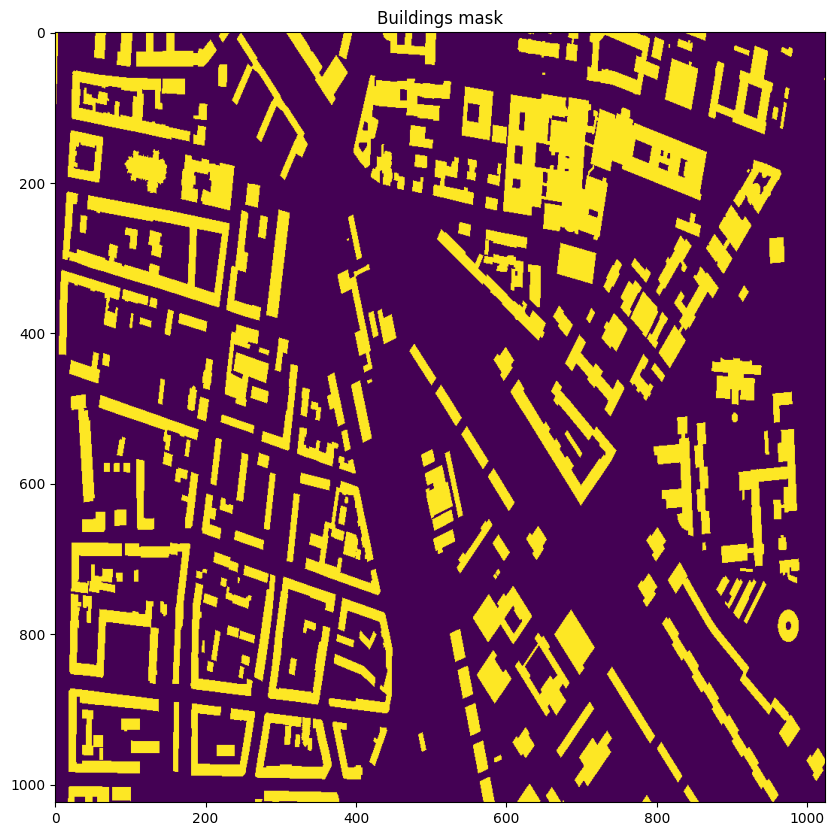

In [11]:
# Create raster
mask = geometry_mask(buildings_gdf.geometry, transform=transform, invert=True, out_shape=(1024, 1024))

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(mask, ax=ax)
ax.set_title("Buildings mask")
plt.show()

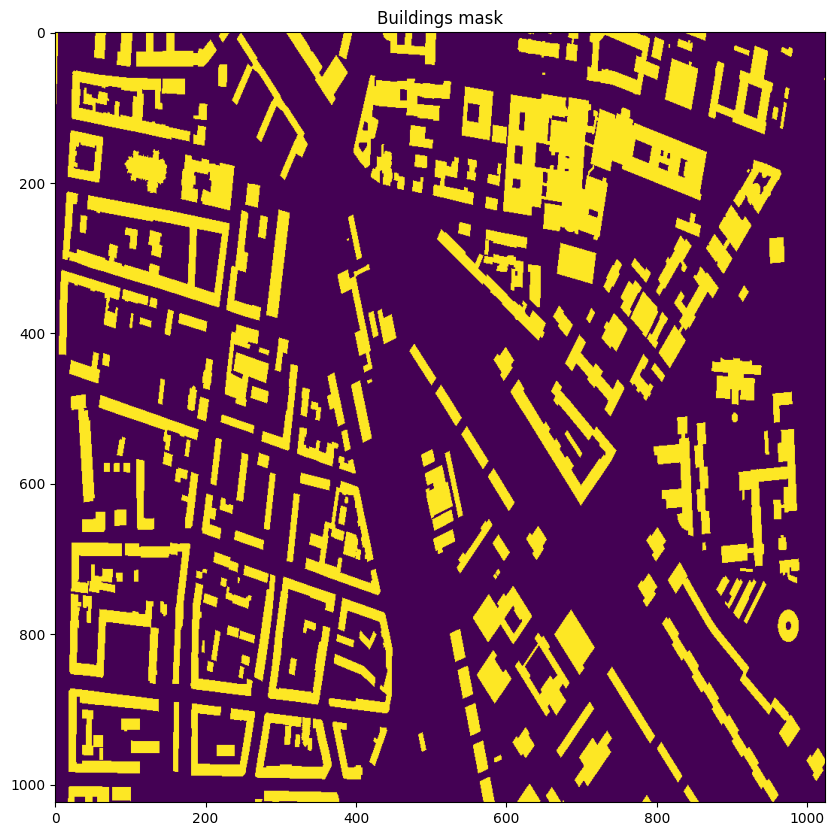

In [17]:
rasterized = rasterize(geom,
    out_shape = (1024, 1024),
    fill = 0,
    out = None,
    transform = transform,
    all_touched = False,
    default_value = 1,
    dtype = None)

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(rasterized, ax=ax)
ax.set_title("Buildings mask")
plt.show()

Display it again on a leaflet map to check the conversion


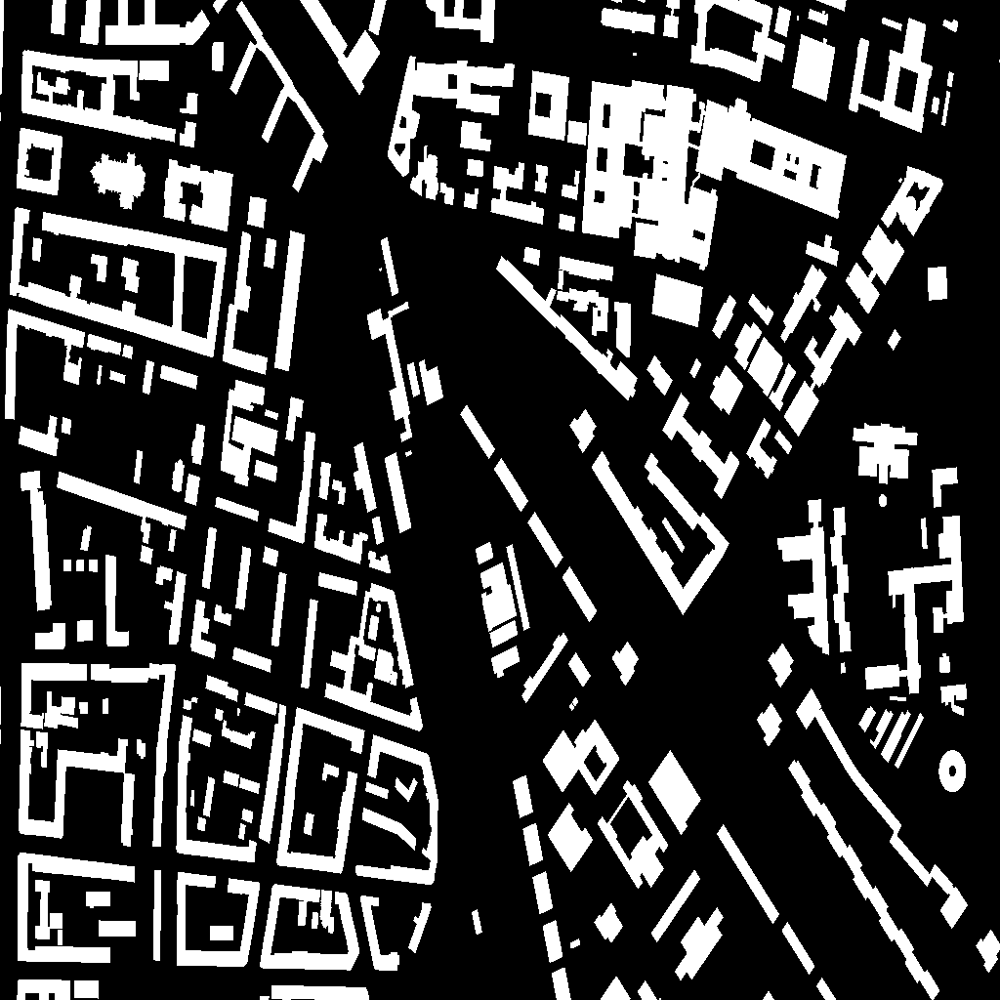

In [18]:
m = folium.Map([37, 0], zoom_start=1)

folium.raster_layers.ImageOverlay(
    image=rasterized,
    bounds=[[ymin, xmin], [ymax, xmax]],
    opacity=0.6,
).add_to(m)
m.add_child(folium.LayerControl())

m

## Download for the whole of Leipzig, seperate it by layers and convert features to xarray datasets

### Get it for the whole of Leipzig

OSMNX is nice for smaller requests to quickly retrieve data. For larger areas, it is better to use the Overpass API directly. The following code will download the data for the whole of Leipzig using multiple threads

In [8]:
# Define the tags you want to query
tags = {
    "building": True,
    "waterway": True,
    "natural": True,
    "highway": True,
    "landuse": True,
    "leisure": ["park", "garden"],
    "place": ["square"],
    "amenity": ["fountain", "school", "university", "college", "hospital", "kindergarten", "place_of_worship"],
    "aeroway": True,
    "railway": True,
}

# Function to suppress logs for Overpass API requests
def suppress_overpass_logs():
    logging.getLogger("urllib3").setLevel(logging.CRITICAL)
    logging.getLogger("requests").setLevel(logging.CRITICAL)

def restore_logs():
    # Restore the default logging level
    logging.getLogger("urllib3").setLevel(logging.NOTSET)
    logging.getLogger("requests").setLevel(logging.NOTSET)

# Create Overpass query for tags
def create_query(bbox, tags):
    query_parts = []
    
    osm_graph_type = "wr"  # nwr, node, way, etc.
    
    for tag, value in tags.items():
        
        # If the value is True, it means we just need to check for the existence of the tag
        if value is True:
            query_parts.append(f'{osm_graph_type}["{tag}"]({bbox[1]},{bbox[0]},{bbox[3]},{bbox[2]});')
        
        elif isinstance(value, list) and len(value) > 1:
            # If the value is a list, use a regex match for multiple possible values
            query_parts.append(f'{osm_graph_type}["{tag}"~"{ "|".join(value)}"]({bbox[1]},{bbox[0]},{bbox[3]},{bbox[2]});')
        # If the value is a single string, use an exact match
        else:
            query_parts.append(f'{osm_graph_type}["{tag}"="{value}"]({bbox[1]},{bbox[0]},{bbox[3]},{bbox[2]});')
            
    #join to a single query without out or other meta statements
    query = "("+"\n".join(query_parts) +");"
    return query


# Initialize the Overpass API
api = overpass.API(debug=False, timeout=900)

def fetch_overpass_data(bbox, tags, retries=5, delay=2):
    
    query = create_query(bbox, tags)
    
    for attempt in range(retries):
        try:
            suppress_overpass_logs()
            response = api.Get(query, responseformat="geojson", verbosity='geom')
            restore_logs()
            
            gdf = gpd.GeoDataFrame.from_features(response['features']) 
            
            #drop nodes column
            if 'nodes' in gdf.columns:
                gdf = gdf.drop(columns=['nodes'])
                
            #create columns for columns.tags
            for col in gdf.columns:
                if col == 'tags':
                    for key, value in gdf[col].items():
                        if isinstance(value, dict):
                            for k, v in value.items():
                                gdf.loc[key, k] = v
                        else:
                            gdf.loc[key, col] = value
                        
                    gdf = gdf.drop(columns=[col])
                
            # drop all columns where not at least 1/len(tags)/2 % data - so columns where for a tag the column has at least 50% of data
            gdf = gdf.dropna(axis=1, thresh=len(gdf) * 1/len(tags)*0.5)
                
            return gdf
        except Exception as e:
            # print(f"Error fetching data: {e}")
            time.sleep(delay)
            
    print(f"Failed to fetch data after {retries} attempts.")
    return None
    
# Multithreaded feature extraction for a grid
def extract_features_grid(grid, tags):
    features = []
    with ThreadPoolExecutor(max_workers=int(mp.cpu_count()/2)) as executor:
        futures = {executor.submit(fetch_overpass_data, row.geometry.bounds, tags): row for _, row in grid.iterrows()}
        for future in tqdm(as_completed(futures), total=len(futures)):
            try:
                features.append(future.result())
            except Exception as e:
                print(f"Error: {e}")
    return pd.concat(features, ignore_index=True)

# Execute the function
leipzig_urban_gdf = extract_features_grid(grid, tags)

100%|██████████| 40/40 [10:13<00:00, 15.34s/it]


In [19]:
# Clean geometry
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]

#remove duplicates by id
leipzig_urban_gdf = leipzig_urban_gdf.drop_duplicates(subset=['id'])

#set crs to EPSG:4326
leipzig_urban_gdf.crs = "EPSG:4326"

#display summary of features
print(f"Number of features: {len(leipzig_urban_gdf)}")
print("\nFeature types:")
print(leipzig_urban_gdf['geometry'].type.value_counts())

Number of features: 222311

Feature types:
Polygon            135576
LineString          84339
MultiPolygon         2388
MultiLineString         8
Name: count, dtype: int64


Write to parquet for easier access

In [20]:
#write to parquet
leipzig_urban_gdf.to_parquet(f"{repo_dir}/data/osm/leipzig_urban_gdf.parquet", index=False)

In [4]:
#read from parquet
leipzig_urban_gdf = gpd.read_parquet(f"{repo_dir}/data/osm/leipzig_urban_gdf.parquet")

#filter out invalid geometries
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]

leipzig_urban_gdf.head(5)

,geometry,type,id,highway,name,surface,access,landuse,addr:city,addr:housenumber,...,electrified,frequency,gauge,voltage,heritage,wikidata,horse,addr:suburb,parking:lane:both,building:use
0,"LINESTRING (12.28738 51.30289, 12.28738 51.302...",way,23238325,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
1,"LINESTRING (12.28957 51.29698, 12.28876 51.298...",way,23238361,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,"LINESTRING (12.28817 51.29892, 12.28839 51.298...",way,23238362,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3,"LINESTRING (12.29061 51.29456, 12.29079 51.294...",way,23238363,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
4,"LINESTRING (12.29424 51.29095, 12.2944 51.2906...",way,24219148,tertiary,Albersdorfer Straße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


### Get street with more appropriate width and convert to xarray ds

Note: smootheness is the "physical usability of a way for wheeled vehicles, particularly regarding surface regularity/flatness" https://wiki.openstreetmap.org/wiki/Key:smoothness

In [22]:
#filter out streets
streets_gdf = leipzig_urban_gdf[leipzig_urban_gdf["highway"].notnull()]
streets_gdf = streets_gdf[streets_gdf.geometry.type == "LineString"]

#remove all columns where more than 50% nans
streets_gdf = streets_gdf.dropna(axis=1, thresh=len(streets_gdf) * 0.5)

#rename lit to lighting
streets_gdf = streets_gdf.rename(columns={"lit": "lighting"})

streets_gdf

,geometry,type,id,highway,surface
0,"LINESTRING (12.28738 51.30289, 12.28738 51.302...",way,23238325,tertiary,asphalt
1,"LINESTRING (12.28957 51.29698, 12.28876 51.298...",way,23238361,tertiary,asphalt
2,"LINESTRING (12.28817 51.29892, 12.28839 51.298...",way,23238362,tertiary,asphalt
3,"LINESTRING (12.29061 51.29456, 12.29079 51.294...",way,23238363,tertiary,asphalt
4,"LINESTRING (12.29424 51.29095, 12.2944 51.2906...",way,24219148,tertiary,asphalt
...,...,...,...,...,...
222288,"LINESTRING (12.4859 51.37901, 12.48596 51.37894)",way,1339048303,service,sett
222293,"LINESTRING (12.48691 51.38182, 12.48743 51.382...",way,1340373736,service,None
222301,"LINESTRING (12.4849 51.37872, 12.48492 51.37873)",way,1353192358,service,asphalt
222302,"LINESTRING (12.48314 51.3795, 12.48318 51.37951)",way,1353192359,residential,None


Convert to polygons with width by feature based buffering

The width for german streets is managed by:
-  Richtlinien für die Anlage von Autobahnen https://www.fgsv-verlag.de/raa-guidelines-for-the-design-of-motorways-edition-2008-translation-2011-englische-ubersetzung
- Richtlinien für die Anlage von Landstraßen https://www.bast.de/DE/Verkehrstechnik/Fachthemen/v1-strassentypen.html

We simplify the values for the different highway classes:


In [24]:
# create a dict for highway classifications and their corresponding widths
widths = {
    'motorway': 24,
    'motorway_link': 16,
    'trunk': 24,
    'trunk_link': 16,
    'primary': 15,
    'primary_link': 12,
    'secondary': 12,
    'secondary_link': 11,
    'tertiary': 11,
    'tertiary_link': 11,
    'residential': 5.5,
    'living_street': 5.5,
    'pedestrian': 2,
    'road': 11,	
    'service': 5.5,
    'minor_service': 5.5,
    'footway': 2,
    'cycleway': 2,
    'path': 2,
    'steps': 2,
}

# Apply the width classification
streets_gdf['buffer_width'] = streets_gdf['highway'].apply(lambda x: widths.get(x, 5.5))  # Default to 5.5 if not found

#convert to projected coordinates (UTM 33N)
streets_gdf = streets_gdf.to_crs(epsg=32633)

# Create the buffer polygons with the appropriate width
streets_gdf["geometry"] = streets_gdf.apply(lambda row: row['geometry'].buffer(row['buffer_width']), axis=1)

# convert back to WGS84
streets_gdf = streets_gdf.to_crs(epsg=4326)

In [26]:
streets_gdf[1:100].explore()

In [71]:
image_size = 4096  

#setup for rasterization
geom = [shapes for shapes in streets_gdf.geometry]
transform = from_bounds(xmin, ymin, xmax, ymax, image_size, image_size)

#convert to raster
rasterized = rasterize(geom,
    out_shape = (image_size, image_size),
    fill = 0,
    out = None,
    transform = transform,
    all_touched = False,
    default_value = 1,
    dtype = None)

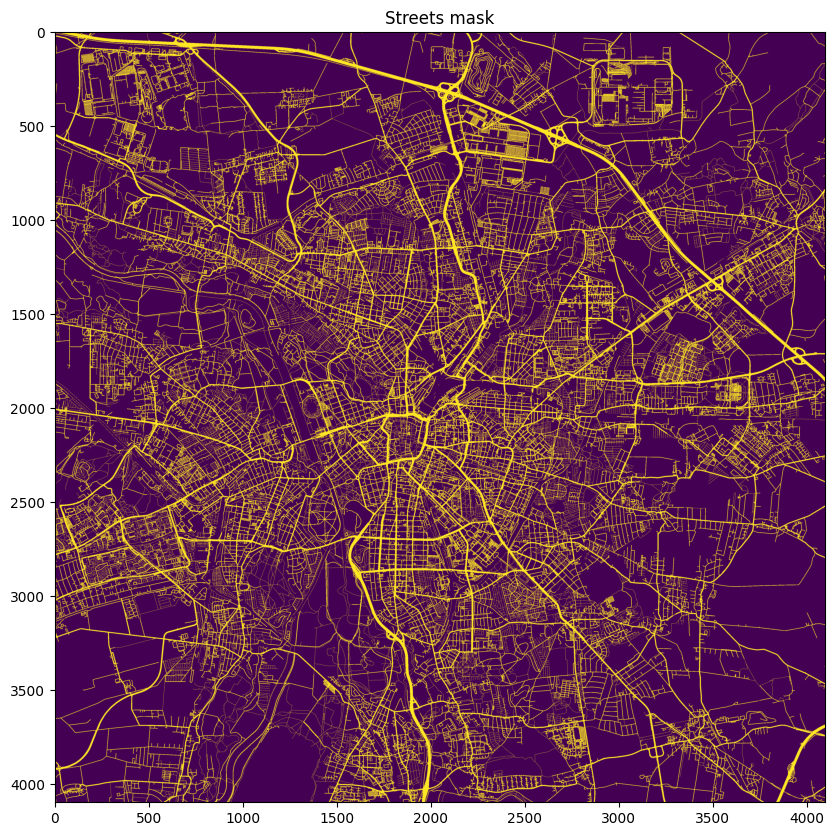

In [30]:
# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(rasterized, ax=ax)
ax.set_title("Streets mask")
plt.show()

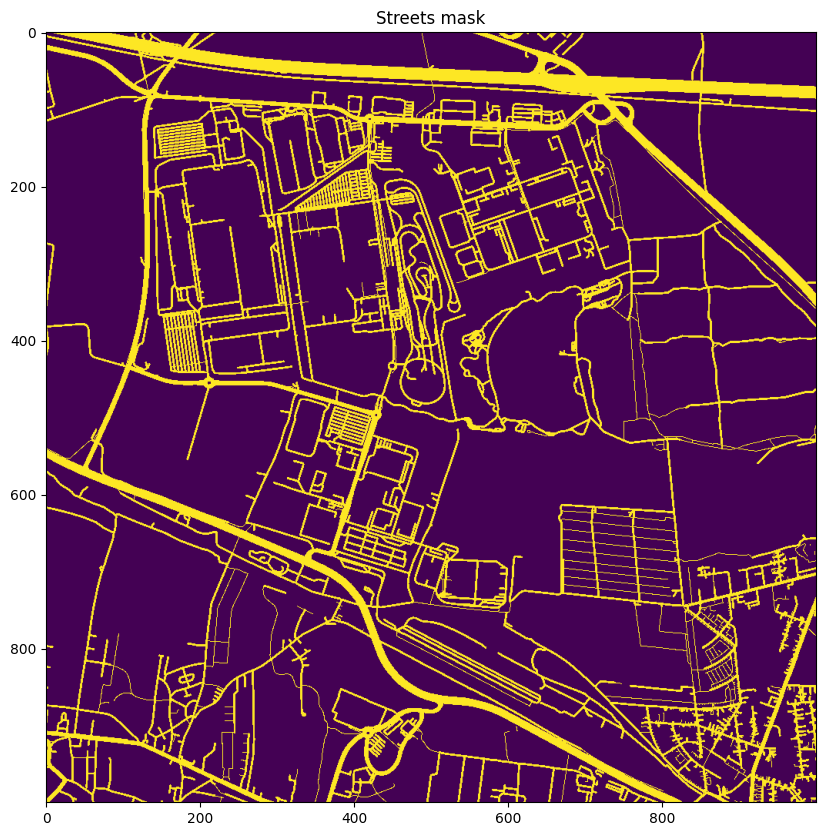

In [32]:
#plot subset of rasterized streets
fig, ax = plt.subplots(figsize=(10, 10))
show(rasterized[0:1000, 0:1000], ax=ax)
ax.set_title("Streets mask")
plt.show()

In [73]:
# Create the lat/lon coordinates again 
lat = np.linspace(ymin, ymax, image_size)
lon = np.linspace(xmin, xmax, image_size)

streets_xr = xr.DataArray(rasterized, dims=["lat", "lon"], coords={"lat": lat, "lon": lon})

# this would only save the image bounds: streets_xr = xr.DataArray(rasterized, dims=["lat", "lon"], coords={"lat": np.arange(image_size), "lon": np.arange(image_size)})
streets_xr = streets_xr.rio.set_crs("EPSG:4326")
streets_xr = streets_xr.rio.set_spatial_dims(x_dim="lat", y_dim="lon")
streets_xr = streets_xr.rio.set_nodata(0)

#set attributes for the raster
streets_xr.attrs['long_name'] = 'Streets OSM'
streets_xr.attrs['description'] = 'Rasterized streets from OSM data'
streets_xr.attrs['units'] = '1'
streets_xr.attrs['grid_mapping'] = 'spatial_ref'
streets_xr.attrs['spatial_ref'] = 'EPSG:4326'
streets_xr.attrs['crs'] = 'EPSG:4326'

#rename to streets
streets_xr.name = "streets"

streets_xr

<xarray.DataArray 'streets' (lat: 4096, lon: 4096)> Size: 134MB
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 1, 1, 1]], shape=(4096, 4096))
Coordinates:
  * lat      (lat) float64 33kB 51.27 51.27 51.27 51.27 ... 51.42 51.42 51.42
  * lon      (lon) float64 33kB 12.27 12.27 12.27 12.27 ... 12.5 12.5 12.5 12.5
Attributes:
    long_name:     Streets OSM
    description:   Rasterized streets from OSM data
    units:         1
    grid_mapping:  spatial_ref
    spatial_ref:   EPSG:4326
    crs:           EPSG:4326

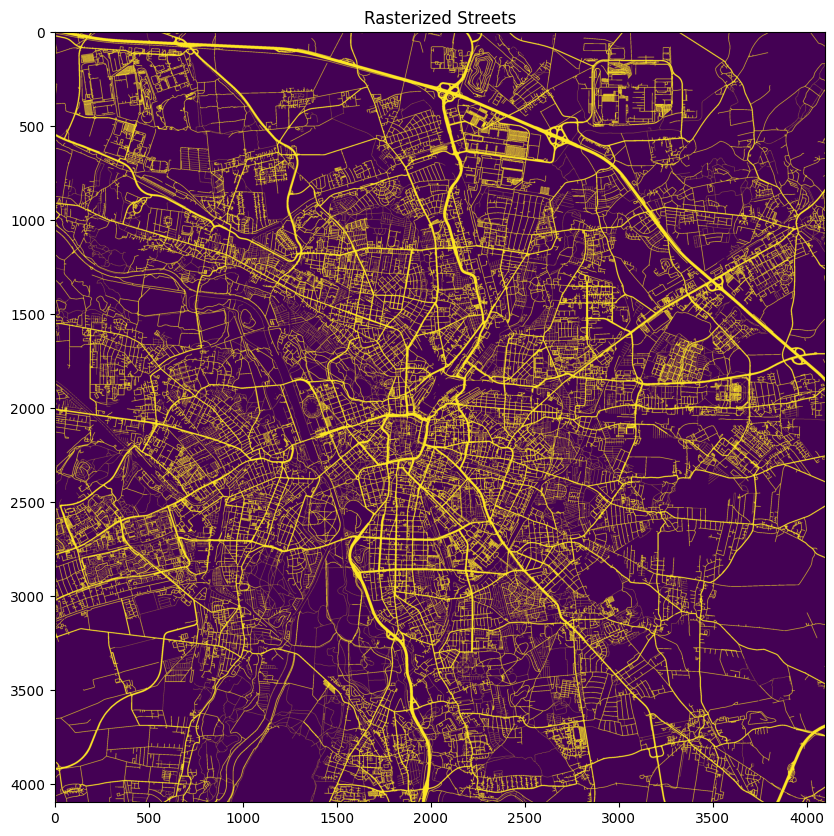

In [49]:
# plot the rasterized streets
fig, ax = plt.subplots(figsize=(10, 10))
show(streets_xr, ax=ax)
ax.set_title("Rasterized Streets")
plt.show()

We can wrap this up in a function and allow to pass a column as well:

In [74]:
def rasterize_gdf(gdf, transform, image_size, col=None):
    """
    Rasterizes a GeoDataFrame with rio rasterize using the specified transform and image size.
    
    Parameters:
    gdf (GeoDataFrame): The GeoDataFrame to rasterize.
    transform (Affine): The affine transformation to apply.
    image_size (int): The size of the output raster image.
    col (str): Optional column name to use for rasterization values.
    """
    
    if col:
        shapes = ((geom,value) for geom, value in zip(gdf.geometry, gdf[col]))
    else: 
        shapes = gdf.geometry.values
    
    return rasterize(
        shapes,
        out_shape=(image_size, image_size),
        fill=0,  # default value (no data)
        transform=transform,
        all_touched=True,  # Ensure that all pixels that touch the geometry are filled
        dtype=np.float32
    )
    
#create transform array and set image size
transform = from_bounds(xmin, ymin, xmax, ymax, image_size, image_size)
image_size = 4096

#map surface column to integers
surface_mapping = {value: idx for idx, value in enumerate(streets_gdf['surface'].unique())}
# apply mapping to the surface column
streets_gdf['surface_int'] = streets_gdf['surface'].map(surface_mapping)


# apply the rasterization for the streets surface column
rasterized = rasterize_gdf(streets_gdf, transform, image_size, col='surface_int')

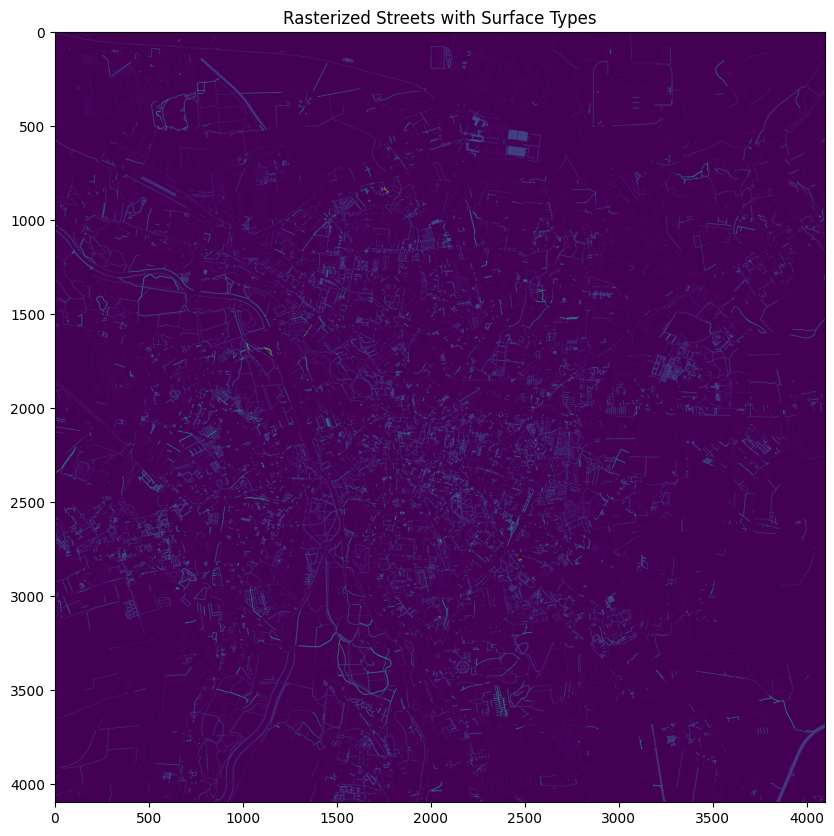

In [69]:
#plot
fig, ax = plt.subplots(figsize=(10, 10))
show(rasterized, ax=ax)
ax.set_title("Rasterized Streets with Surface Types")

plt.show()

In [75]:
#convert to xarray
streets_xr_surface = xr.DataArray(rasterized, dims=["lat", "lon"], coords={"lat": lat, "lon": lon})
streets_xr_surface = streets_xr_surface.rio.set_crs("EPSG:4326")
streets_xr_surface = streets_xr_surface.rio.set_spatial_dims(x_dim="lat", y_dim="lon")
streets_xr_surface = streets_xr_surface.rio.set_nodata(0)

# set attributes for the raster
streets_xr_surface.attrs['long_name'] = 'Streets OSM surface'
streets_xr_surface.attrs['description'] = 'Rasterized streets with surface types from OSM data'
streets_xr_surface.attrs['units'] = '1'
streets_xr_surface.attrs['grid_mapping'] = 'spatial_ref'
streets_xr_surface.attrs['spatial_ref'] = 'EPSG:4326'
streets_xr_surface.attrs['crs'] = 'EPSG:4326'
streets_xr_surface.attrs['surface_mapping'] = json.dumps(surface_mapping)

# rename to streets_surface
streets_xr_surface.name = "streets_surface"

In [80]:
#merge the two rasters
streets_xr = xr.merge([streets_xr, streets_xr_surface])

#save to geotiff
streets_xr.to_zarr(f"{repo_dir}/data/osm/types/rasterized_streets.zarr", mode="w", consolidated=True, compute=True)

In [81]:
streets_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_streets.zarr", consolidated=True, decode_times=False)
streets_xr

<xarray.Dataset> Size: 201MB
Dimensions:          (lat: 4096, lon: 4096)
Coordinates:
  * lat              (lat) float64 33kB 51.27 51.27 51.27 ... 51.42 51.42 51.42
  * lon              (lon) float64 33kB 12.27 12.27 12.27 ... 12.5 12.5 12.5
Data variables:
    streets          (lat, lon) int64 134MB ...
    streets_surface  (lat, lon) float32 67MB ...
Attributes:
    long_name:     Streets OSM
    description:   Rasterized streets from OSM data
    units:         1
    grid_mapping:  spatial_ref
    spatial_ref:   EPSG:4326
    crs:           EPSG:4326

### Save buildings with attributes to xarray ds

In [91]:
# buildings gdf
buildings_gdf = leipzig_urban_gdf[leipzig_urban_gdf["building"].notnull()]

#at least 50% of data in the columns
buildings_gdf = buildings_gdf.dropna(axis=1, thresh=len(buildings_gdf) * 0.5)

buildings_gdf

,geometry,type,id,addr:housenumber,building
114,"POLYGON ((12.30044 51.28108, 12.30044 51.28117...",way,124051917,2,residential
115,"POLYGON ((12.30007 51.28109, 12.30017 51.28109...",way,124052306,1,yes
116,"POLYGON ((12.30001 51.28163, 12.30024 51.28162...",way,124052854,9,residential
117,"POLYGON ((12.30001 51.2815, 12.30022 51.2815, ...",way,124052855,7,residential
118,"POLYGON ((12.30045 51.28493, 12.30059 51.28493...",way,124343038,37b,yes
...,...,...,...,...,...
222298,"POLYGON ((12.48187 51.37431, 12.4818 51.37439,...",way,1350910925,4,apartments
222299,"POLYGON ((12.48173 51.37446, 12.48166 51.37453...",way,1350910926,2,apartments
222300,"POLYGON ((12.48481 51.38401, 12.48503 51.38395...",way,1351508010,4,apartments
222305,"POLYGON ((12.51092 51.38227, 12.51112 51.38228...",way,1355636847,54,school


In [ ]:
# define transform and image size for rasterization
image_size = 4096
transform = from_bounds(xmin, ymin, xmax, ymax, image_size, image_size)

#map building column to integers
building_mapping = {value: idx for idx, value in enumerate(buildings_gdf['building'].unique())}
# apply mapping to the building column
buildings_gdf['building_int'] = buildings_gdf['building'].map(building_mapping)

#rasterize building column
rasterized_buildings= rasterize_gdf(buildings_gdf, transform, image_size, col='building_int')

In [94]:
#create xarray dataarray
buildings_xr = xr.DataArray(rasterized_buildings, dims=["lat", "lon"], coords={"lat": lat, "lon": lon})
buildings_xr = buildings_xr.rio.set_crs("EPSG:4326")
buildings_xr = buildings_xr.rio.set_spatial_dims(x_dim="lat", y_dim="lon")
buildings_xr = buildings_xr.rio.set_nodata(0)

# set attributes for the raster
buildings_xr.attrs['long_name'] = 'Buildings OSM'
buildings_xr.attrs['description'] = 'Rasterized buildings from OSM data'
buildings_xr.attrs['units'] = '1'
buildings_xr.attrs['grid_mapping'] = 'spatial_ref'
buildings_xr.attrs['spatial_ref'] = 'EPSG:4326'
buildings_xr.attrs['crs'] = 'EPSG:4326'
buildings_xr.attrs['building_mapping'] = json.dumps(building_mapping)

# rename to buildings
buildings_xr.name = "buildings"

#save to zarr
buildings_xr.to_zarr(f"{repo_dir}/data/osm/types/rasterized_buildings.zarr", mode="w", consolidated=True, compute=True)

In [95]:
#merge with streets ds
buildings_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_buildings.zarr", consolidated=True, decode_times=False)
streets_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_streets.zarr", consolidated=True, decode_times=False)
merged_xr = xr.merge([streets_xr, buildings_xr])

merged_xr

<xarray.Dataset> Size: 269MB
Dimensions:          (lat: 4096, lon: 4096)
Coordinates:
  * lat              (lat) float64 33kB 51.27 51.27 51.27 ... 51.42 51.42 51.42
  * lon              (lon) float64 33kB 12.27 12.27 12.27 ... 12.5 12.5 12.5
Data variables:
    streets          (lat, lon) int64 134MB ...
    streets_surface  (lat, lon) float32 67MB ...
    buildings        (lat, lon) float32 67MB ...
Attributes:
    long_name:     Streets OSM
    description:   Rasterized streets from OSM data
    units:         1
    grid_mapping:  spatial_ref
    spatial_ref:   EPSG:4326
    crs:           EPSG:4326

In [98]:
buildings_xr.buildings

<xarray.DataArray 'buildings' (lat: 4096, lon: 4096)> Size: 67MB
[16777216 values with dtype=float32]
Coordinates:
  * lat      (lat) float64 33kB 51.27 51.27 51.27 51.27 ... 51.42 51.42 51.42
  * lon      (lon) float64 33kB 12.27 12.27 12.27 12.27 ... 12.5 12.5 12.5 12.5
Attributes:
    long_name:         Buildings OSM
    description:       Rasterized buildings from OSM data
    units:             1
    grid_mapping:      spatial_ref
    spatial_ref:       EPSG:4326
    crs:               EPSG:4326
    building_mapping:  {"residential": 0, "yes": 1, "detached": 2, "garage": ...

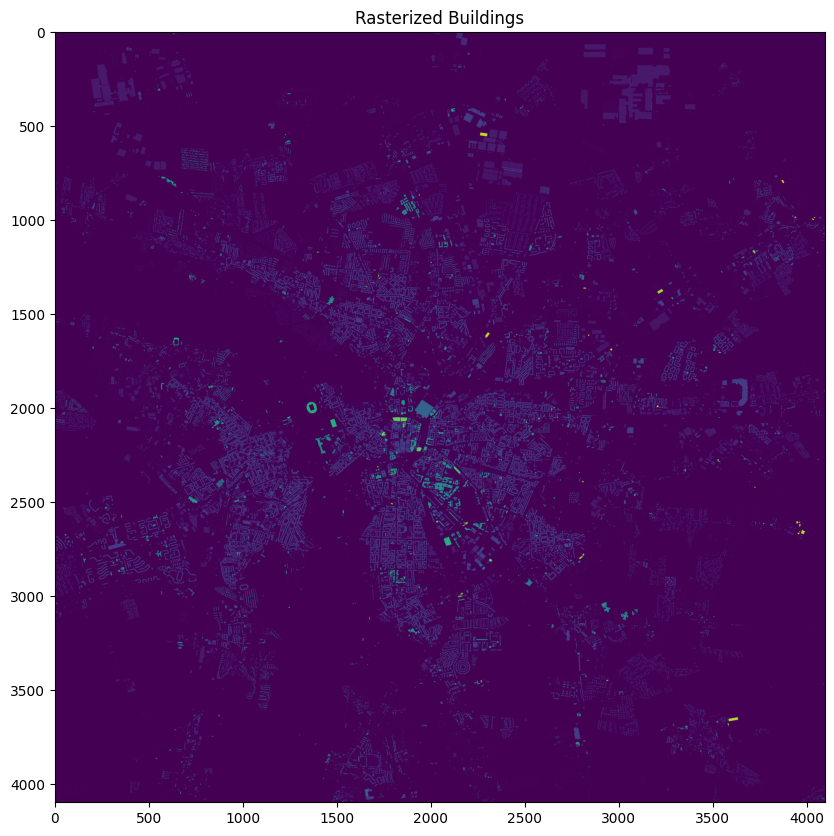

In [99]:
#plot buildings
fig, ax = plt.subplots(figsize=(10, 10))
show(buildings_xr.buildings, ax=ax)
ax.set_title("Rasterized Buildings")
plt.show()

### 3D buildings from Yangzi Che et al.

3D-GloBFP: the first global three-dimensional building footprint dataset
https://essd.copernicus.org/articles/16/5357/2024/essd-16-5357-2024-assets.html

In [ ]:
#read buildings shapefile
building_heights_gdf = gpd.read_file(f"{repo_dir}/data/che_etal/Germany_Hungary_Iceland/Germany.shp", mask=bbox_gdf)#rows=slice(0, 500000))

In [37]:
query = f"""
COPY (
    SELECT * 
    FROM ST_Read('{repo_dir}/data/che_etal/Germany_Hungary_Iceland/Germany.shp') 
    WHERE ST_Within(geom, ST_MakeEnvelope(CAST({xmin} AS DOUBLE), CAST({ymin} AS DOUBLE), 
                                          CAST({xmax} AS DOUBLE), CAST({ymax} AS DOUBLE)))
) TO 'building_heights_germany.geojson' WITH (FORMAT GDAL, DRIVER 'GeoJSON');
"""

# Install and load the spatial extension
duckdb.sql("""INSTALL spatial;
LOAD spatial;""")

duckdb.sql(query)


FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [12]:
building_heights_gdf

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

┌─────────┬───────────┬──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────┐
│  FID_1  │  Height   │                                                                                                                                                                                                                                                                                                 geom                                                                             

In [15]:
building_heights_gdf=building_heights_gdf.pl().to_pandas()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [ ]:
from shapely import wkb

building_heights_gdf=building_heights_gdf.assign(geometry=building_heights_gdf.geom.apply(wkb.loads))

Using GDALs ogr2ogr directly in a docker container is probably the fastest conversion to parquet:

```bash

docker pull osgeo/gdal:ubuntu-full-3.5.2
docker run --rm -it -v ${PWD}/data/che_etal/Germany_Hungary_Iceland:/data osgeo/gdal:ubuntu-full-3.5.2 `
  ogr2ogr `
  /data/building_heights_germany.parquet `
  /data/Germany.shp `
  -dialect SQLite `
  -sql "SELECT geometry, Height FROM 'Germany'" `
  -lco COMPRESSION=BROTLI `
  -lco POLYGON_ORIENTATION=COUNTERCLOCKWISE `
  -lco ROW_GROUP_SIZE=9999999

```



In [17]:
# save to parquet for ease of use
building_heights_gdf.to_parquet(f"{repo_dir}/data/che_etal/building_heights_germany.parquet", index=False)

In [ ]:
building_heights_gdf=gpd.read_parquet(f"{repo_dir}/data/che_etal/Germany_Hungary_Iceland/building_heights_germany.parquet")
building_heights_gdf.head(5)

In [39]:
building_heights_gdf=gpd.read_file(f"{repo_dir}/data/che_etal/building_heights_germany.geojson")

In [41]:
building_heights_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [42]:
# define transform and image size for rasterization
image_size = 4096
transform = from_bounds(xmin, ymin, xmax, ymax, image_size, image_size)

def rasterize_gdf(gdf, transform, image_size, col=None):
    """
    Rasterizes a GeoDataFrame with rio rasterize using the specified transform and image size.
    
    Parameters:
    gdf (GeoDataFrame): The GeoDataFrame to rasterize.
    transform (Affine): The affine transformation to apply.
    image_size (int): The size of the output raster image.
    col (str): Optional column name to use for rasterization values.
    """
    
    if col:
        shapes = ((geom,value) for geom, value in zip(gdf.geometry, gdf[col]))
    else: 
        shapes = gdf.geometry.values
    
    return rasterize(
        shapes,
        out_shape=(image_size, image_size),
        fill=0,  # default value (no data)
        transform=transform,
        all_touched=True,  # Ensure that all pixels that touch the geometry are filled
        dtype=np.float32
    )

#rasterize landuse column
rasterized_landuse= rasterize_gdf(building_heights_gdf, transform, image_size, col='Height')

In [43]:
# Create the lat/lon coordinates again 
lat = np.linspace(ymin, ymax, image_size)
lon = np.linspace(xmin, xmax, image_size)

# create xarray dataarray
building_heights_xr = xr.DataArray(rasterized_landuse, dims=["lat", "lon"], coords={"lat": lat, "lon": lon})
building_heights_xr = building_heights_xr.rio.set_crs("EPSG:4326")
building_heights_xr = building_heights_xr.rio.set_spatial_dims(x_dim="lat", y_dim="lon")
building_heights_xr = building_heights_xr.rio.set_nodata(0)

# set attributes for the raster
building_heights_xr.attrs['long_name'] = 'Building Heights OSM'
building_heights_xr.attrs['description'] = 'Rasterized building heights from OSM data'
building_heights_xr.attrs['units'] = '1'
building_heights_xr.attrs['grid_mapping'] = 'spatial_ref'
building_heights_xr.attrs['spatial_ref'] = 'EPSG:4326'
building_heights_xr.attrs['crs'] = 'EPSG:4326'

# rename to building heights
building_heights_xr.name = "building_heights"

#save to zarr
building_heights_xr.to_zarr(f"{repo_dir}/data/osm/types/rasterized_building_heights.zarr", mode="w", consolidated=True, compute=True)

In [44]:
#merge with streets ds
building_heights_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_building_heights.zarr", consolidated=True, decode_times=False)
streets_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_streets.zarr", consolidated=True, decode_times=False)
buildings_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_buildings.zarr", consolidated=True, decode_times=False)
landuse_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_landuse.zarr", consolidated=True, decode_times=False)
merged_xr = xr.merge([streets_xr, buildings_xr, building_heights_xr, landuse_xr])
merged_xr

<xarray.Dataset> Size: 403MB
Dimensions:           (lat: 4096, lon: 4096)
Coordinates:
  * lat               (lat) float64 33kB 51.27 51.27 51.27 ... 51.42 51.42 51.42
  * lon               (lon) float64 33kB 12.27 12.27 12.27 ... 12.5 12.5 12.5
Data variables:
    streets           (lat, lon) int64 134MB ...
    streets_surface   (lat, lon) float32 67MB ...
    buildings         (lat, lon) float32 67MB ...
    building_heights  (lat, lon) float32 67MB ...
    landuse           (lat, lon) float32 67MB ...
Attributes:
    long_name:     Streets OSM
    description:   Rasterized streets from OSM data
    units:         1
    grid_mapping:  spatial_ref
    spatial_ref:   EPSG:4326
    crs:           EPSG:4326

In [45]:
#save merged xarray to zarr
merged_xr.to_zarr(f"{repo_dir}/data/osm/osm_landuse_rasterized.zarr", mode="w", consolidated=True, compute=True)

In [46]:
osm_landuse_xr = xr.open_zarr(f"{repo_dir}/data/osm/osm_landuse_rasterized.zarr", consolidated=True, decode_times=False)
osm_landuse_xr

<xarray.Dataset> Size: 403MB
Dimensions:           (lat: 4096, lon: 4096)
Coordinates:
  * lon               (lon) float64 33kB 12.27 12.27 12.27 ... 12.5 12.5 12.5
  * lat               (lat) float64 33kB 51.27 51.27 51.27 ... 51.42 51.42 51.42
Data variables:
    landuse           (lat, lon) float32 67MB ...
    building_heights  (lat, lon) float32 67MB ...
    streets           (lat, lon) int64 134MB ...
    buildings         (lat, lon) float32 67MB ...
    streets_surface   (lat, lon) float32 67MB ...
Attributes:
    long_name:     Streets OSM
    description:   Rasterized streets from OSM data
    units:         1
    grid_mapping:  spatial_ref
    spatial_ref:   EPSG:4326
    crs:           EPSG:4326

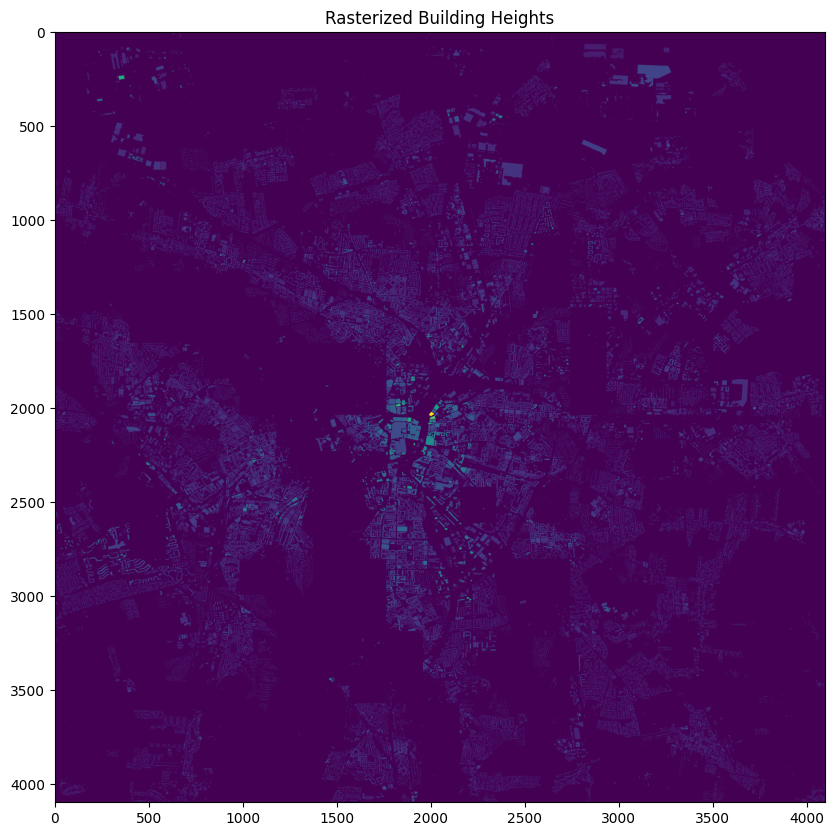

In [47]:
#plot building heights
fig, ax = plt.subplots(figsize=(10, 10))
show(building_heights_xr.building_heights, ax=ax)
ax.set_title("Rasterized Building Heights")
plt.show()

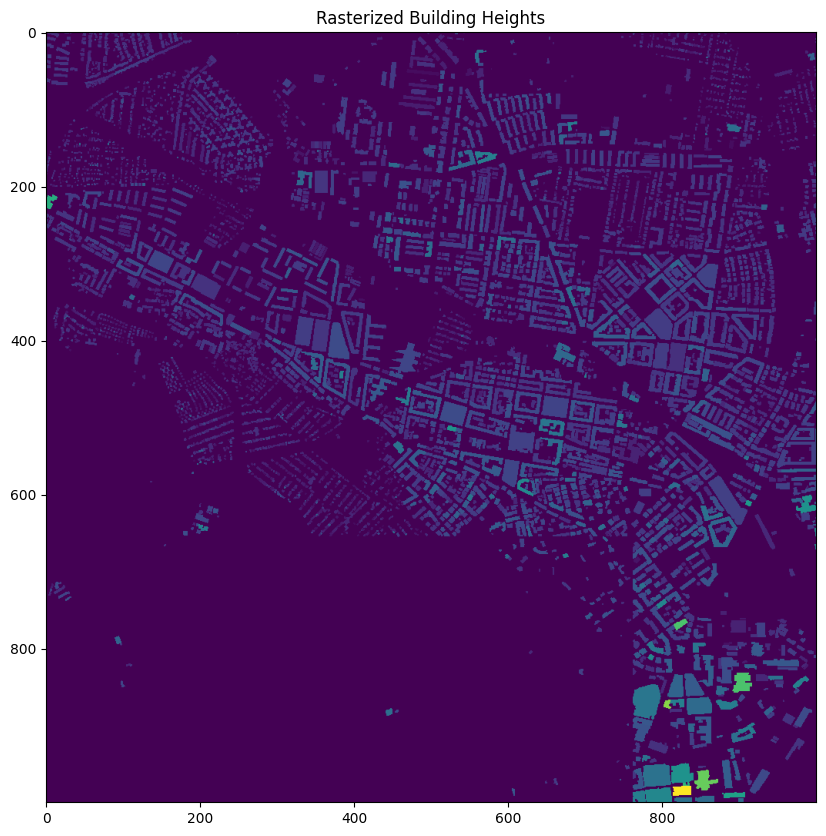

In [48]:
#subset plot from the center
fig, ax = plt.subplots(figsize=(10, 10))
show(building_heights_xr.building_heights[1000:2000, 1000:2000], ax=ax)
ax.set_title("Rasterized Building Heights")
plt.show()

### landuse 

In [103]:
# everything that is not streets or buildings
landuse_gdf = leipzig_urban_gdf[~leipzig_urban_gdf["building"].notnull() & ~leipzig_urban_gdf["highway"].notnull() & ~leipzig_urban_gdf["railway"].notnull()]
landuse_gdf = landuse_gdf[landuse_gdf.geometry.is_valid]

#at least 50% of data in the columns
landuse_gdf = landuse_gdf.dropna(axis=1, thresh=len(landuse_gdf) * 0.3)

landuse_gdf

,geometry,type,id,landuse
24,"POLYGON ((12.29017 51.2787, 12.29041 51.28059,...",way,30575393,residential
25,"POLYGON ((12.29266 51.27682, 12.2927 51.27724,...",way,30575491,residential
27,"POLYGON ((12.27988 51.27184, 12.28 51.2719, 12...",way,30578987,residential
62,"POLYGON ((12.27899 51.27735, 12.28557 51.27851...",way,83623712,farmland
63,"POLYGON ((12.29266 51.27682, 12.29988 51.27657...",way,83623714,farmland
...,...,...,...,...
222304,"POLYGON ((12.51084 51.38234, 12.51152 51.38238...",way,1355636846,None
222306,"MULTIPOLYGON (((12.51439 51.36572, 12.51491 51...",multipolygon,2611825,farmland
222307,"MULTIPOLYGON (((12.50462 51.38148, 12.50462 51...",multipolygon,12849755,None
222308,"MULTIPOLYGON (((12.48841 51.38067, 12.48838 51...",multipolygon,13855465,railway


In [ ]:
# define transform and image size for rasterization
image_size = 4096
transform = from_bounds(xmin, ymin, xmax, ymax, image_size, image_size)

#map landuse column to integers
landuse_mapping = {value: idx for idx, value in enumerate(landuse_gdf['landuse'].unique())}
# apply mapping to the landuse column
landuse_gdf['landuse_int'] = landuse_gdf['landuse'].map(landuse_mapping)

#rasterize landuse column
rasterized_landuse= rasterize_gdf(landuse_gdf, transform, image_size, col='landuse_int')

In [105]:
# create xarray dataarray
landuse_xr = xr.DataArray(rasterized_landuse, dims=["lat", "lon"], coords={"lat": lat, "lon": lon})
landuse_xr = landuse_xr.rio.set_crs("EPSG:4326")
landuse_xr = landuse_xr.rio.set_spatial_dims(x_dim="lat", y_dim="lon")
landuse_xr = landuse_xr.rio.set_nodata(0)

# set attributes for the raster
landuse_xr.attrs['long_name'] = 'Landuse OSM'
landuse_xr.attrs['description'] = 'Rasterized landuse from OSM data'
landuse_xr.attrs['units'] = '1'
landuse_xr.attrs['grid_mapping'] = 'spatial_ref'
landuse_xr.attrs['spatial_ref'] = 'EPSG:4326'
landuse_xr.attrs['crs'] = 'EPSG:4326'
landuse_xr.attrs['landuse_mapping'] = json.dumps(landuse_mapping)

# rename to landuse
landuse_xr.name = "landuse"

#save to zarr
landuse_xr.to_zarr(f"{repo_dir}/data/osm/types/rasterized_landuse.zarr", mode="w", consolidated=True, compute=True)

In [30]:
# merge with streets and buildings ds
landuse_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_landuse.zarr", consolidated=True, decode_times=False)
streets_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_streets.zarr", consolidated=True, decode_times=False)
buildings_xr = xr.open_zarr(f"{repo_dir}/data/osm/types/rasterized_buildings.zarr", consolidated=True, decode_times=False)
merged_xr = xr.merge([streets_xr, buildings_xr, landuse_xr])

In [31]:
merged_xr

<xarray.Dataset> Size: 336MB
Dimensions:          (lat: 4096, lon: 4096)
Coordinates:
  * lat              (lat) float64 33kB 51.27 51.27 51.27 ... 51.42 51.42 51.42
  * lon              (lon) float64 33kB 12.27 12.27 12.27 ... 12.5 12.5 12.5
Data variables:
    streets          (lat, lon) int64 134MB ...
    streets_surface  (lat, lon) float32 67MB ...
    buildings        (lat, lon) float32 67MB ...
    landuse          (lat, lon) float32 67MB ...
Attributes:
    long_name:     Streets OSM
    description:   Rasterized streets from OSM data
    units:         1
    grid_mapping:  spatial_ref
    spatial_ref:   EPSG:4326
    crs:           EPSG:4326

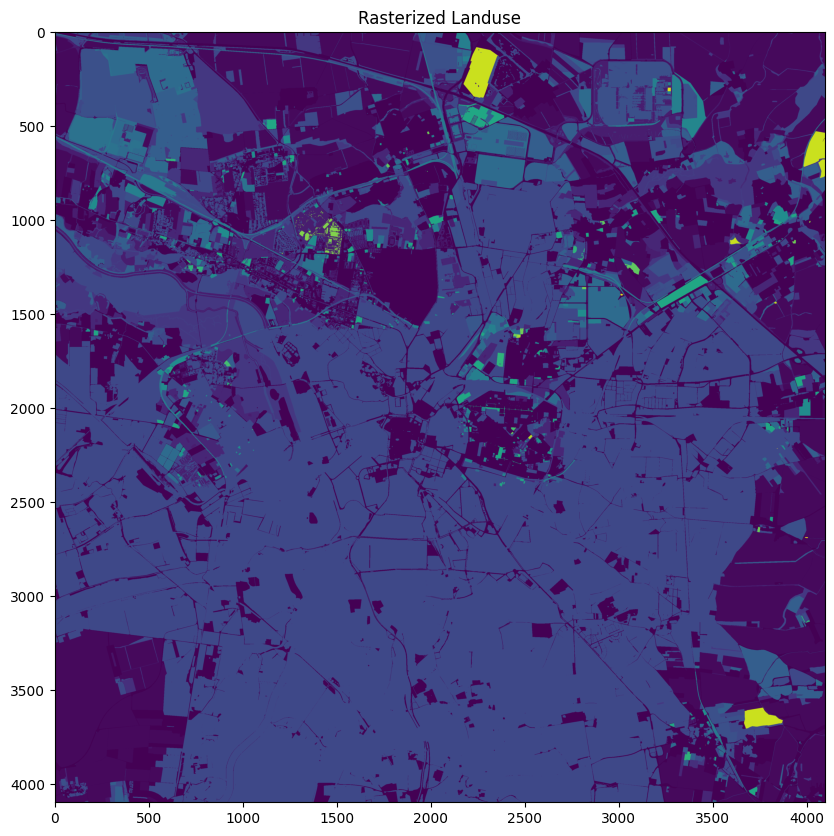

In [32]:
#plot landuse
fig, ax = plt.subplots(figsize=(10, 10))
show(landuse_xr.landuse, ax=ax)
ax.set_title("Rasterized Landuse")
plt.show()

## Possible model filter/ User input

The model should be able to adapt to:

- surroundings:
    - waterbodies
    - streets
    - other buildings and their heights
    - sufficient green space
    - (later even service functions possible)

- filter for temperature (and even humidity) using the Landsat thermal images 

Users should be able to select the following parameters:

- percentage of green space
- volume perccentage of building types (residential space, mixed use, commercial, industrial, etc.)
--> the model should maybe identify which building layout might be suitable?
- a climate scenario or maximum temperature development